In [1]:
import pandas as pd
import re
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier, VotingClassifier
from sklearn.naive_bayes import MultinomialNB
from sklearn.metrics import classification_report, accuracy_score, confusion_matrix
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud
nltk.download('stopwords')
nltk.download('punkt')
nltk.download('wordnet')


[nltk_data] Downloading package stopwords to /usr/share/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to /usr/share/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to /usr/share/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


True

# Data visualize

/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


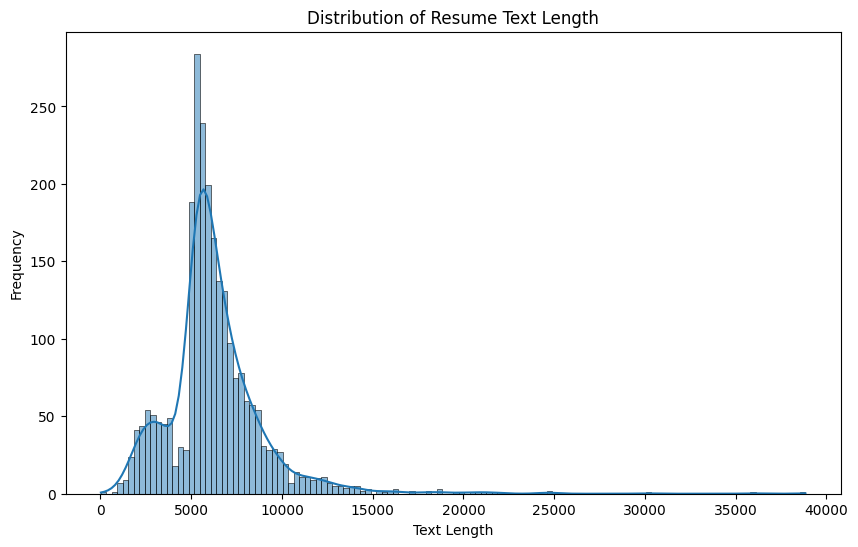

In [2]:
data = pd.read_csv('/kaggle/input/ba-task-dataset/Resume/Resume.csv')
# Calculate text length for Resume_str
data['Text_Length'] = data['Resume_str'].apply(len)


plt.figure(figsize=(10, 6))
sns.histplot(data['Text_Length'], kde=True)
plt.title('Distribution of Resume Text Length')
plt.xlabel('Text Length')
plt.ylabel('Frequency')
plt.show()

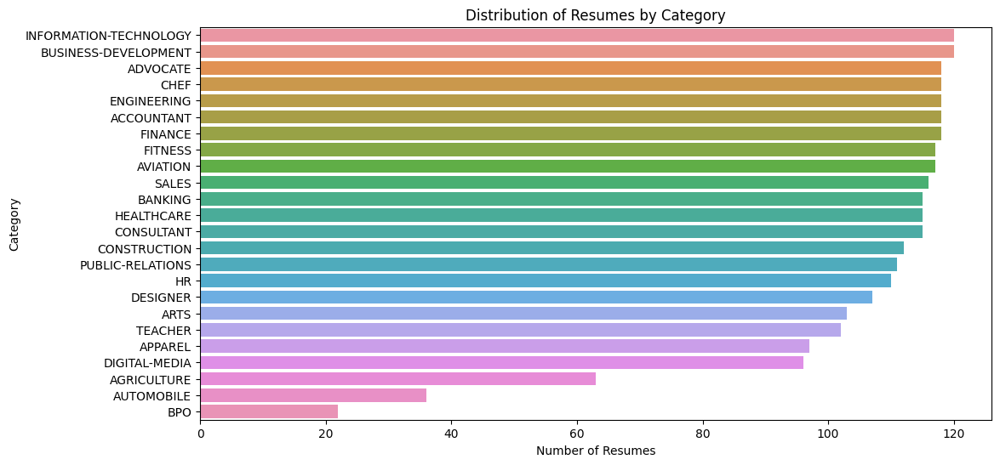

In [3]:
# Plot the distribution of categories
plt.figure(figsize=(12, 6))
sns.countplot(y=data['Category'], order = data['Category'].value_counts().index)
plt.title('Distribution of Resumes by Category')
plt.xlabel('Number of Resumes')
plt.ylabel('Category')
plt.show()

Word Cloud

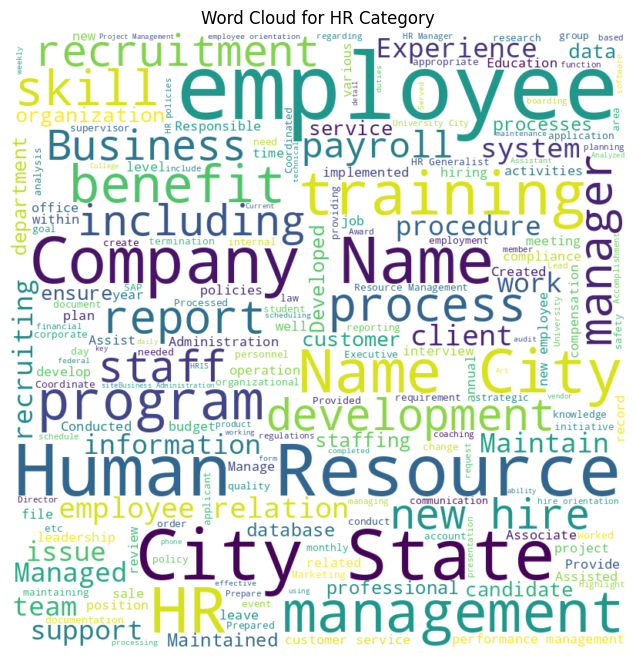

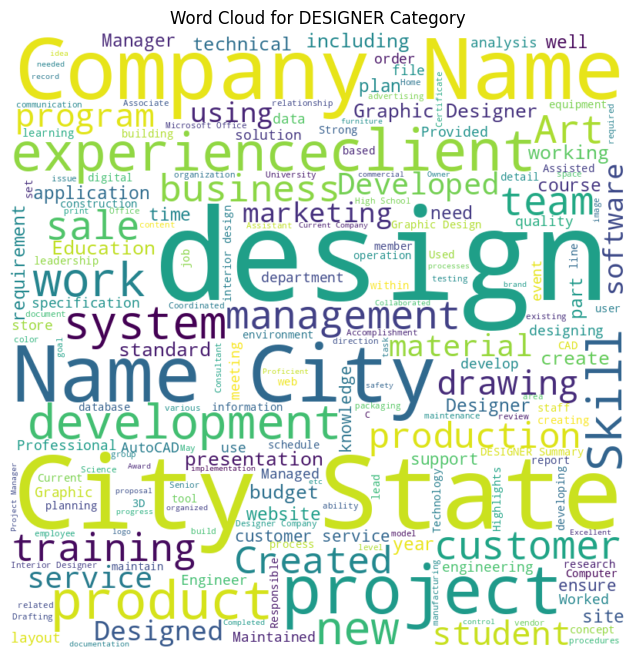

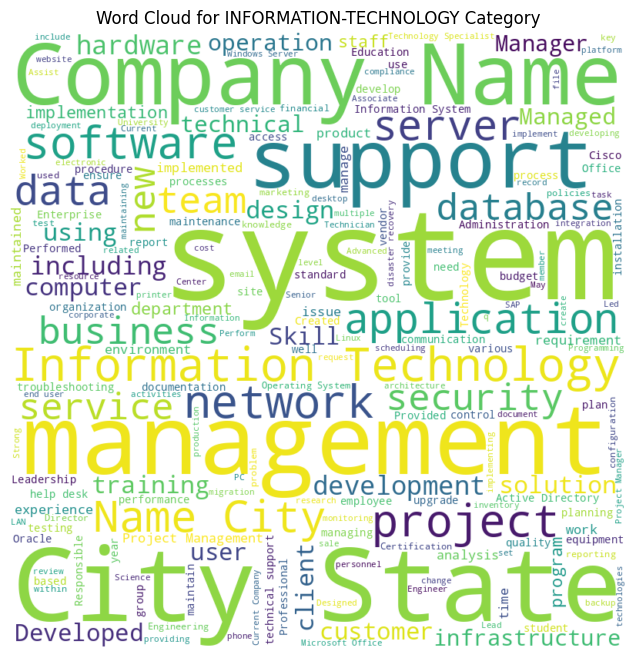

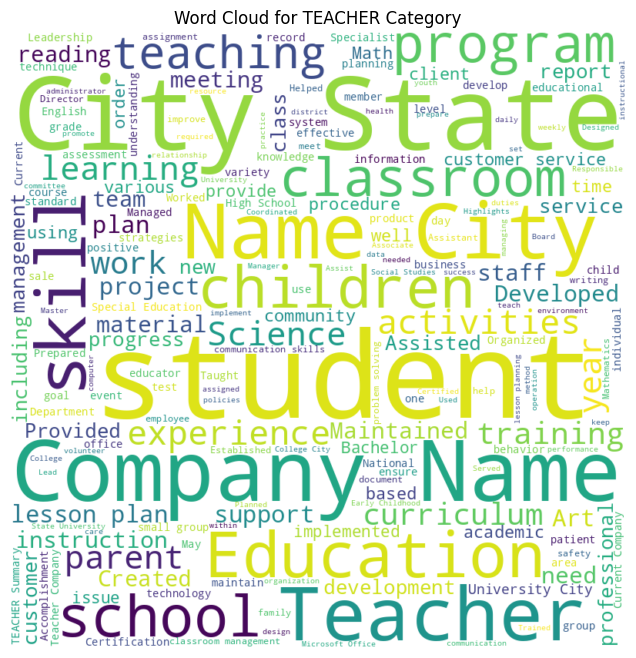

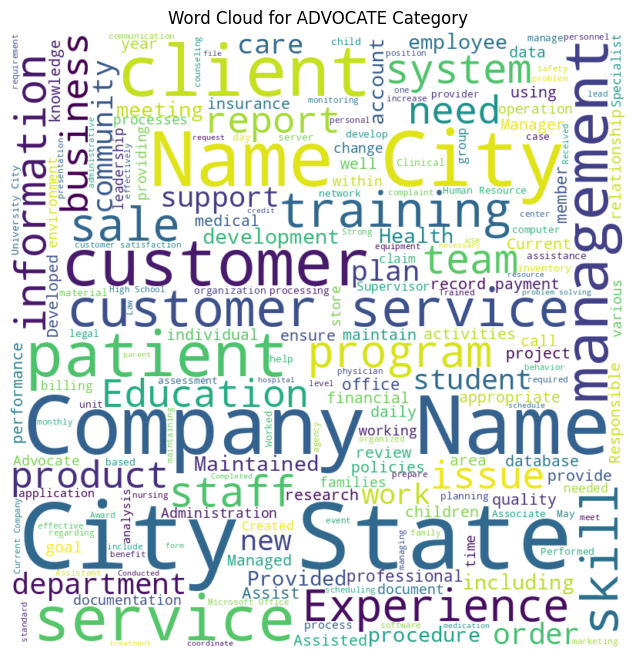

...

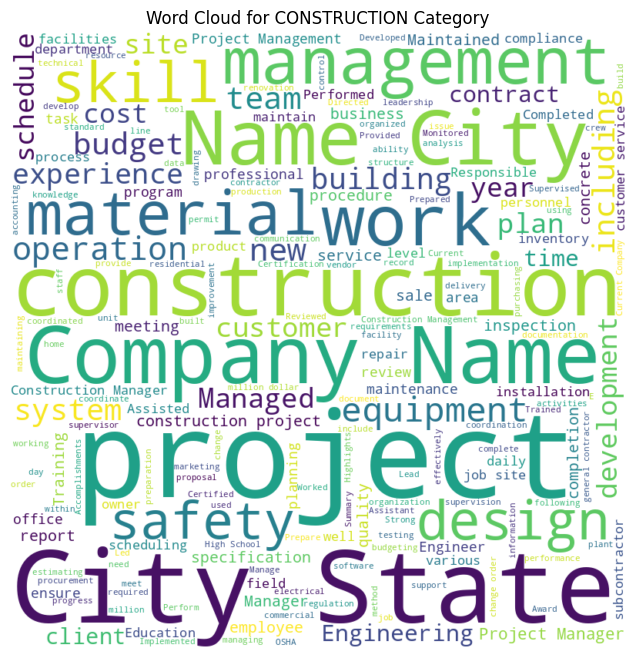

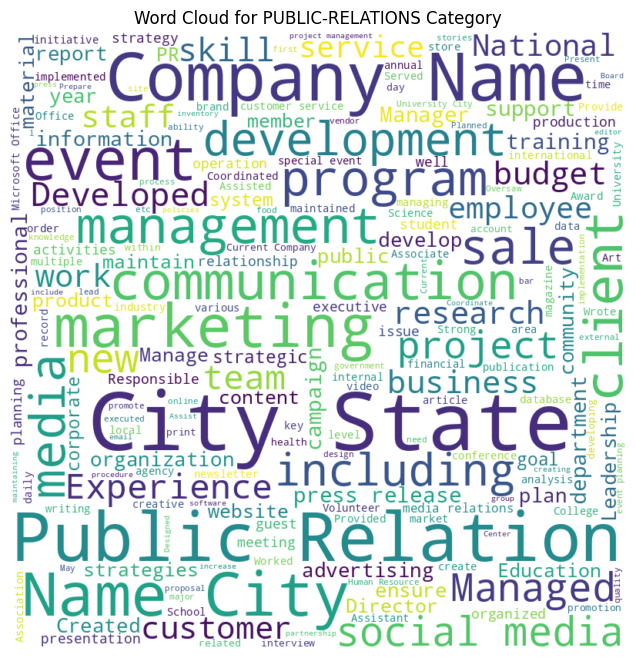

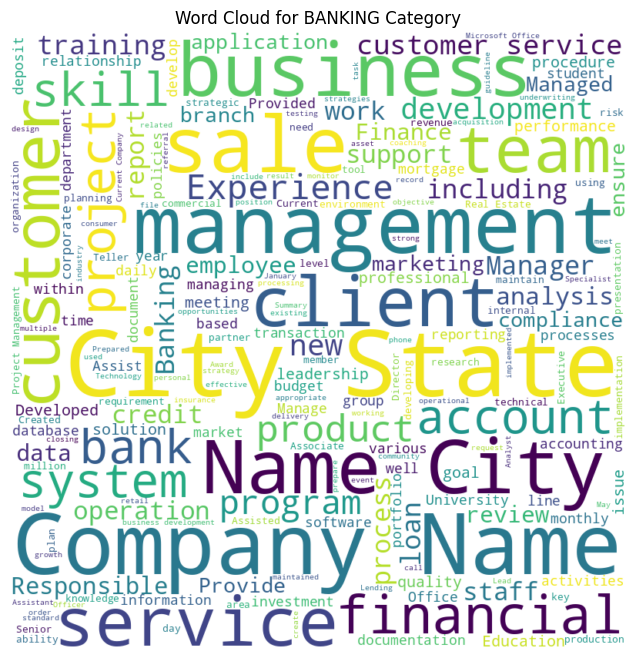

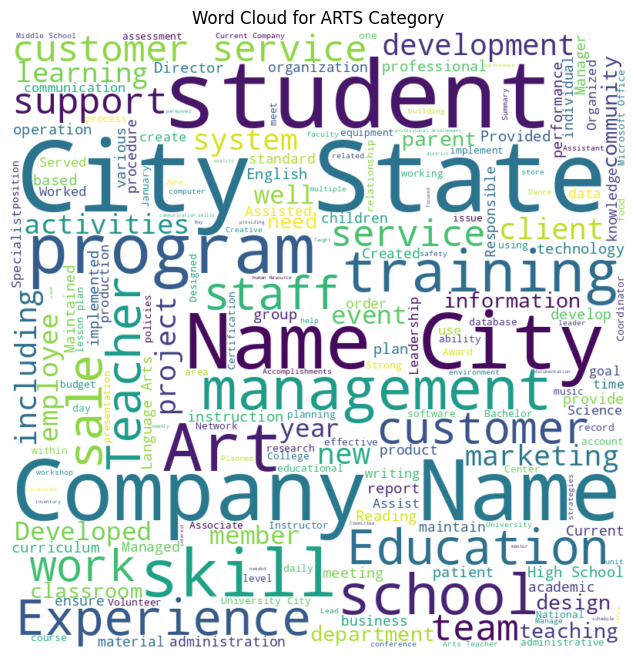

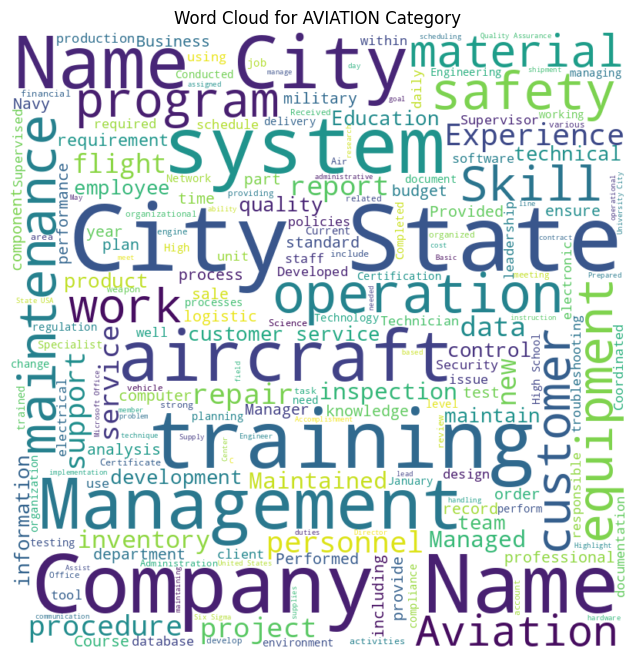

In [4]:
categories = data['Category'].unique()

for category in categories:
    plt.figure(figsize=(8, 8))
    text = ' '.join(data[data['Category'] == category]['Resume_str'])
    wordcloud = WordCloud(width=800, height=800, background_color='white').generate(text)
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.title(f'Word Cloud for {category} Category')
    plt.axis('off')
    plt.show()

# DATA cleaning

In [5]:
import pandas as pd
data = pd.read_csv('/kaggle/input/ba-task-dataset/Resume/Resume.csv')
# Drop rows where 'Resume_str' or 'Category' are missing
data_cleaned = data.dropna(subset=['Resume_str', 'Category'])

# Add a new column for text length
data_cleaned['Text_Length'] = data_cleaned['Resume_str'].apply(len)

In [6]:
!unzip /usr/share/nltk_data/corpora/wordnet.zip -d /usr/share/nltk_data/corpora/

Archive:  /usr/share/nltk_data/corpora/wordnet.zip
   creating: /usr/share/nltk_data/corpora/wordnet/
  inflating: /usr/share/nltk_data/corpora/wordnet/lexnames  
  inflating: /usr/share/nltk_data/corpora/wordnet/data.verb  
  inflating: /usr/share/nltk_data/corpora/wordnet/index.adv  
  inflating: /usr/share/nltk_data/corpora/wordnet/adv.exc  
  inflating: /usr/share/nltk_data/corpora/wordnet/index.verb  
  inflating: /usr/share/nltk_data/corpora/wordnet/cntlist.rev  
  inflating: /usr/share/nltk_data/corpora/wordnet/data.adj  
  inflating: /usr/share/nltk_data/corpora/wordnet/index.adj  
  inflating: /usr/share/nltk_data/corpora/wordnet/LICENSE  
  inflating: /usr/share/nltk_data/corpora/wordnet/citation.bib  
  inflating: /usr/share/nltk_data/corpora/wordnet/noun.exc  
  inflating: /usr/share/nltk_data/corpora/wordnet/verb.exc  
  inflating: /usr/share/nltk_data/corpora/wordnet/README  
  inflating: /usr/share/nltk_data/corpora/wordnet/index.sense  
  inflating: /usr/share/nltk_data

In [7]:
# Initialize lemmatizer and stop words
lemmatizer = WordNetLemmatizer()
stop_words = set(stopwords.words('english'))

# Function to clean and preprocess text
def preprocess_text(text):
    # Convert to lowercase
    text = text.lower()
    
    # Remove HTML tags
    text = re.sub(r'<.*?>', ' ', text)
    
    # Remove special characters, numbers, and extra spaces
    text = re.sub(r'[^a-zA-Z\s]', '', text)
    text = re.sub(r'\s+', ' ', text).strip()
    
    # Tokenize the text
    words = word_tokenize(text)
    
    # Remove stopwords and lemmatize
    words = [lemmatizer.lemmatize(word) for word in words if word not in stop_words]
    
    # Remove short words (less than 3 characters)
    words = [word for word in words if len(word) > 2]
    
    return ' '.join(words)

# Apply the preprocessing function to the 'Resume_str' column
data_cleaned['Resume_str_cleaned'] = data_cleaned['Resume_str'].apply(preprocess_text)

In [8]:
data_cleaned['Resume_str_cleaned']

0       administratormarketing associate administrator...
1       specialist operation summary versatile medium ...
2       director summary year experience recruiting pl...
3       specialist summary dedicated driven dynamic ye...
4       manager skill highlight skill department start...
                              ...                        
2479    rank sgte non commissioned officer charge brig...
2480    government relation communication organization...
2481    geek squad agent professional profile support ...
2482    program director office manager summary highly...
2483    storekeeper professional summary purpose docum...
Name: Resume_str_cleaned, Length: 2484, dtype: object

/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


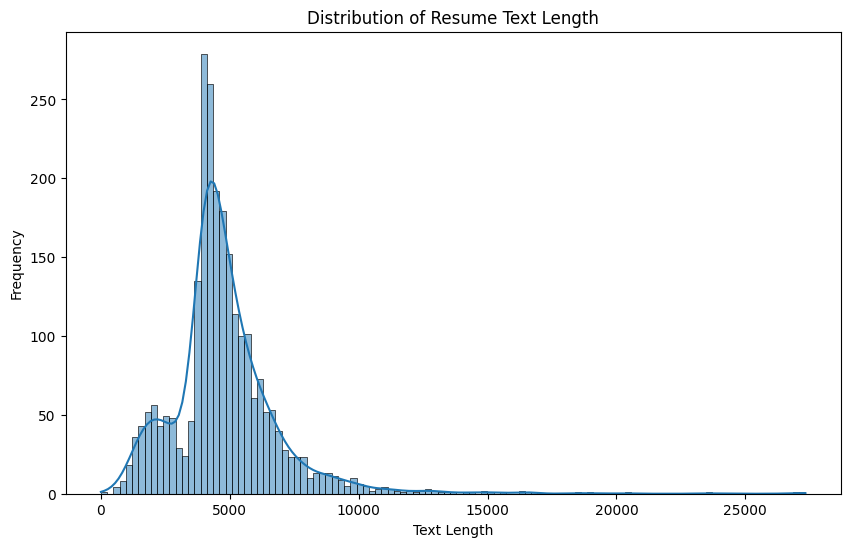

In [9]:
# Calculate text length for Resume_str
data['Text_Length'] = data_cleaned['Resume_str_cleaned'].apply(len)

# Plot the distribution of text length
plt.figure(figsize=(10, 6))
sns.histplot(data['Text_Length'], kde=True)
plt.title('Distribution of Resume Text Length')
plt.xlabel('Text Length')
plt.ylabel('Frequency')
plt.show()

In [10]:
from sklearn.feature_extraction.text import CountVectorizer

# Generate bigrams and trigrams
vectorizer = CountVectorizer(ngram_range=(2, 3), max_features=100)
X_ngrams = vectorizer.fit_transform(data_cleaned['Resume_str_cleaned'])

# Convert to DataFrame to examine
ngram_df = pd.DataFrame(X_ngrams.toarray(), columns=vectorizer.get_feature_names_out())

# Sum up the occurrences of each n-gram and display the top ones
ngram_counts = ngram_df.sum().sort_values(ascending=False).head(20)
print("Top 20 n-grams:")
print(ngram_counts)


Top 20 n-grams:
city state               14107
company name             11563
company name city         9900
name city                 9900
name city state           9719
customer service          3049
human resource            1244
current company           1177
current company name      1173
project management        1172
microsoft office          1138
university city           1107
high school               1080
university city state     1030
business development       904
communication skill        840
public relation            774
bachelor science           769
team member                760
social medium              750
dtype: int64


# Removing Frequent N-gram words

Some words are occured too many times. For example City, state etc. These words has no impact on resume features. So we can remove these words


In [11]:
# List of n-grams to remove
ngrams_to_remove = ['city state', 'company name', 'name city', 'name city state', 
                    'current company name', 'high school', 'microsoft office', 'team member']

# Function to remove n-grams
def remove_ngrams(text, ngrams):
    for ngram in ngrams:
        text = text.replace(ngram, '')
    return text

# Apply the removal to the preprocessed text
data_cleaned['Resume_str_cleaned'] = data_cleaned['Resume_str_cleaned'].apply(lambda x: remove_ngrams(x, ngrams_to_remove))


In [12]:
from sklearn.feature_extraction.text import CountVectorizer

# Generate bigrams and trigrams
vectorizer = CountVectorizer(ngram_range=(2, 3), max_features=100)
X_ngrams = vectorizer.fit_transform(data_cleaned['Resume_str_cleaned'])

ngram_df = pd.DataFrame(X_ngrams.toarray(), columns=vectorizer.get_feature_names_out())

ngram_counts = ngram_df.sum().sort_values(ascending=False).head(20)
print("Top 20 n-grams:")
print(ngram_counts)


Top 20 n-grams:
customer service           3049
human resource             1244
project management         1172
business development        904
communication skill         840
public relation             774
bachelor science            769
social medium               750
policy procedure            710
information technology      654
business administration     643
year experience             639
problem solving             614
customer satisfaction       610
january january             590
financial statement         567
education training          543
project manager             523
state university            521
general ledger              512
dtype: int64


/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


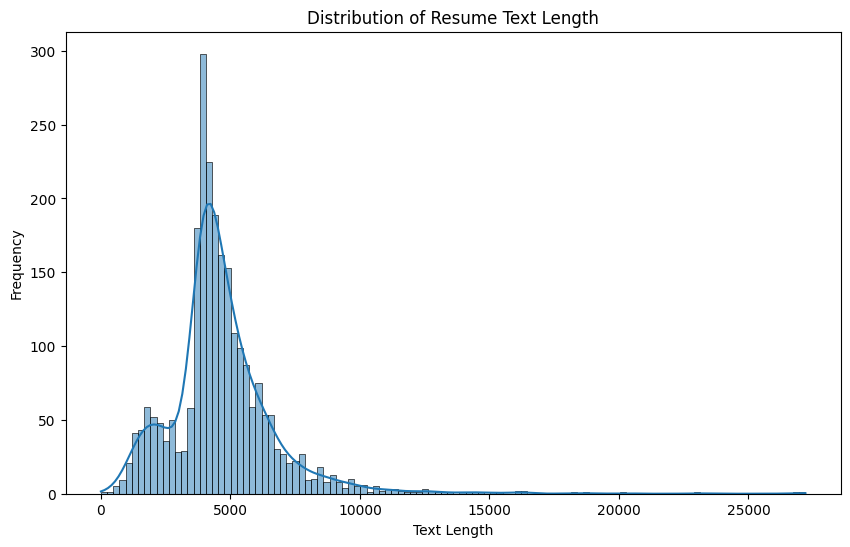

In [13]:
# Calculate text length for Resume_str
data['Text_Length'] = data_cleaned['Resume_str_cleaned'].apply(len)

# Plot the distribution of text length
plt.figure(figsize=(10, 6))
sns.histplot(data['Text_Length'], kde=True)
plt.title('Distribution of Resume Text Length')
plt.xlabel('Text Length')
plt.ylabel('Frequency')
plt.show()

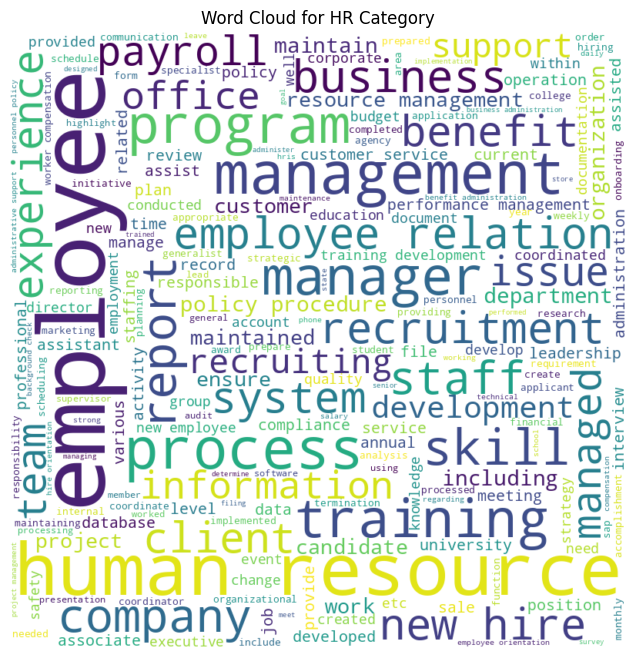

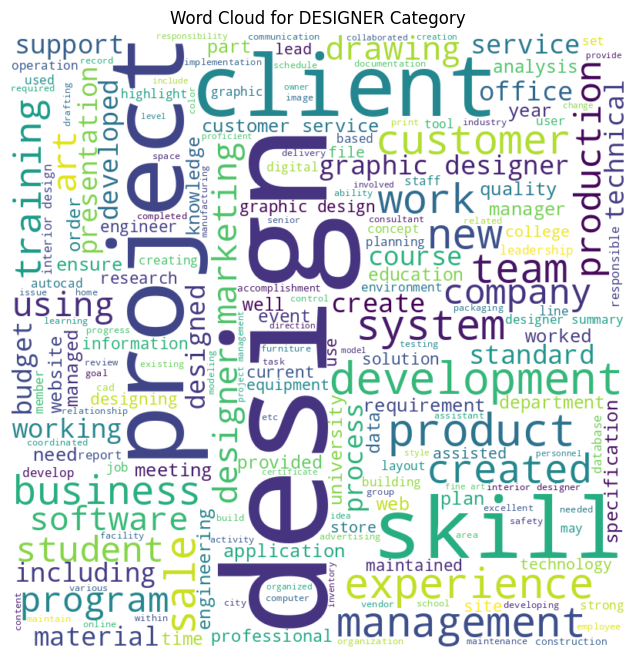

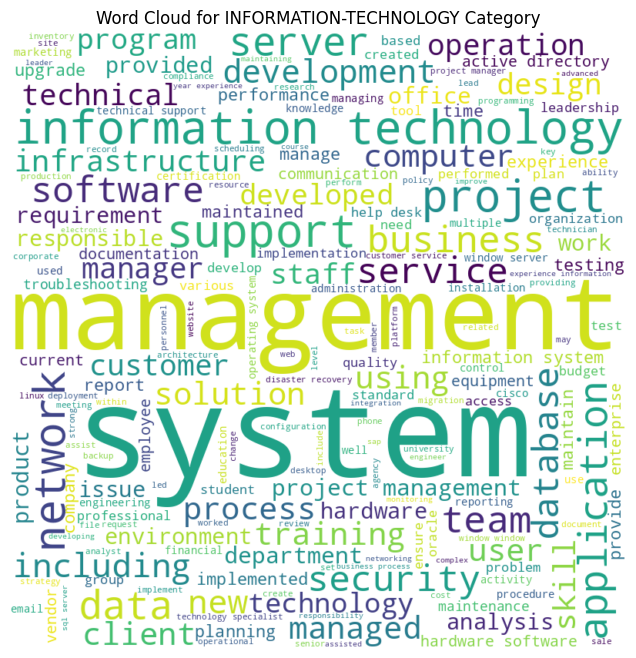

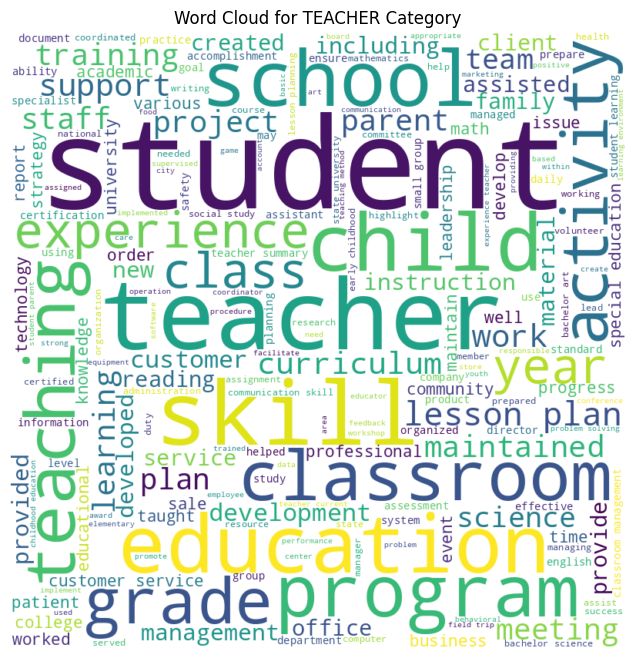

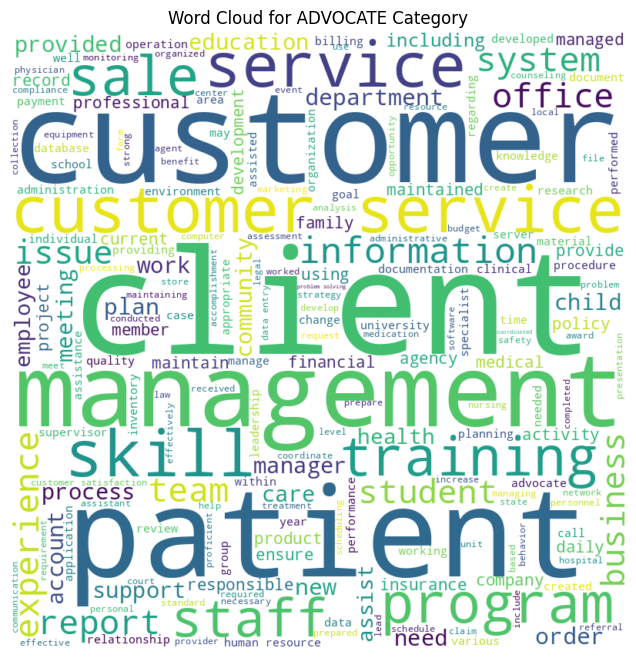

...

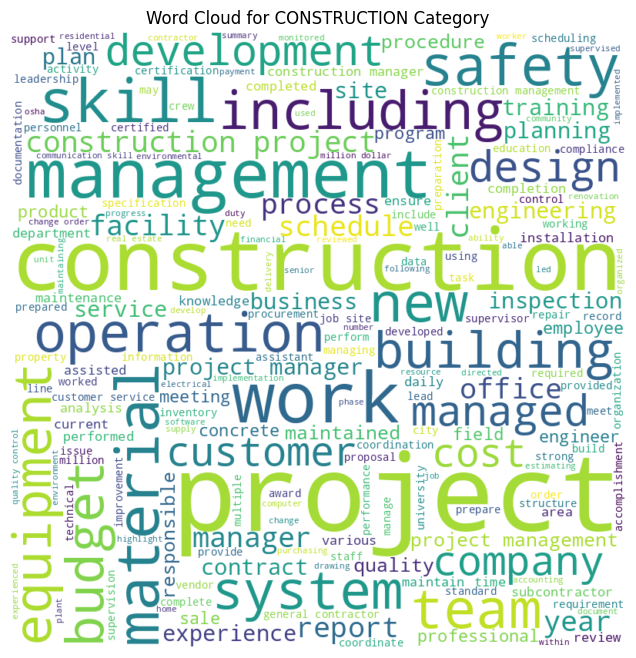

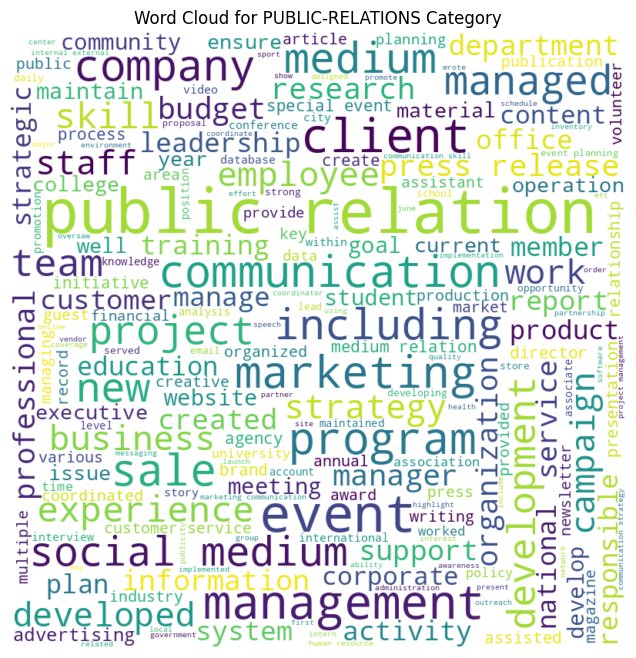

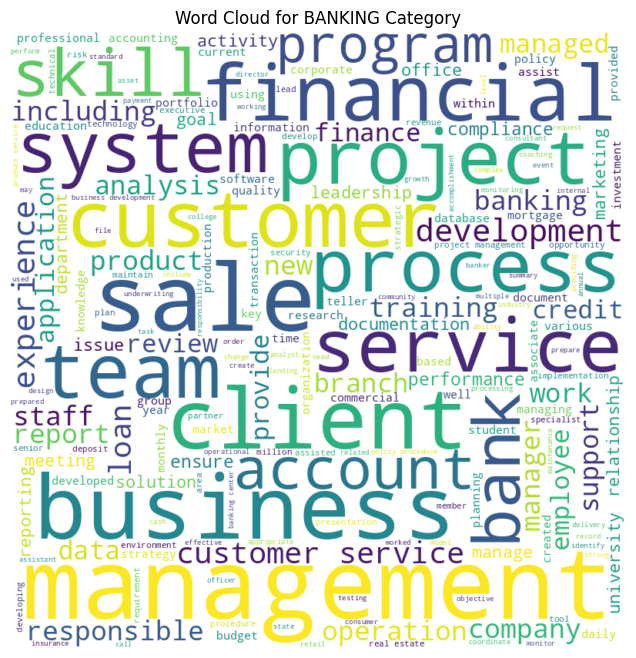

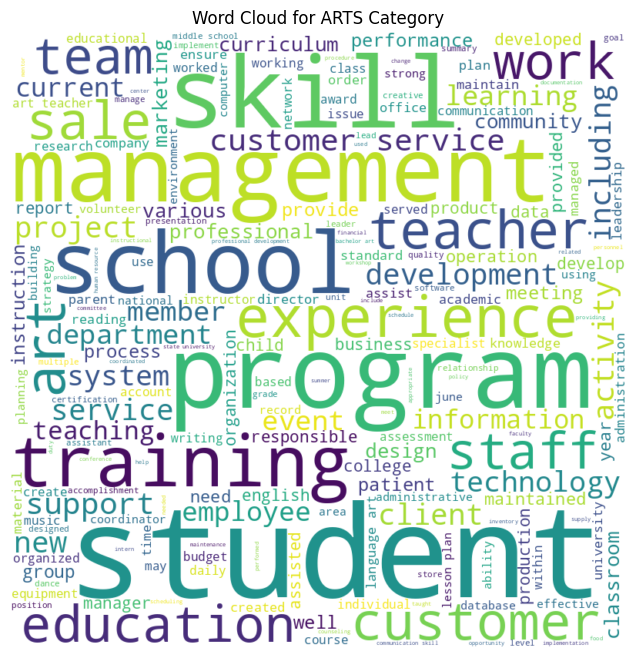

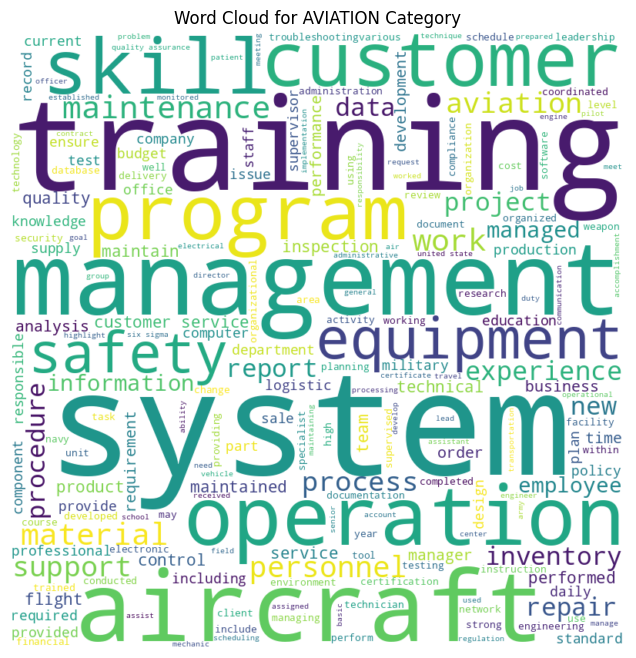

In [14]:
categories = data_cleaned['Category'].unique()

for category in categories:
    plt.figure(figsize=(8, 8))
    text = ' '.join(data_cleaned[data_cleaned['Category'] == category]['Resume_str_cleaned'])
    wordcloud = WordCloud(width=800, height=800, background_color='white').generate(text)
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.title(f'Word Cloud for {category} Category')
    plt.axis('off')
    plt.show()

In [15]:
# Convert the cleaned text data to TF-IDF vectors
tfidf = TfidfVectorizer(max_features=10000, ngram_range=(1, 2))
X = tfidf.fit_transform(data_cleaned['Resume_str_cleaned'])

# Convert labels to numerical format using LabelEncoder
label_encoder = LabelEncoder()
y = label_encoder.fit_transform(data_cleaned['Category'])


In [16]:

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


In [17]:
import pickle
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier, VotingClassifier
from sklearn.naive_bayes import MultinomialNB


log_clf = LogisticRegression(max_iter=1000)
svc_clf = SVC(kernel='linear', probability=True)
rf_clf = RandomForestClassifier(n_estimators=100, random_state=42)
nb_clf = MultinomialNB()
gb_clf = GradientBoostingClassifier(n_estimators=100, random_state=42)


voting_clf = VotingClassifier(
    estimators=[('lr', log_clf), ('svc', svc_clf), ('rf', rf_clf), ('nb', nb_clf), ('gb', gb_clf)],
    voting='soft'  

# Train the ensemble model
voting_clf.fit(X_train, y_train)

# Save the model to a file
with open('voting_classifier_model.pkl', 'wb') as model_file:
    pickle.dump(voting_clf, model_file)

print("Model saved successfully.")


Model saved successfully.


In [18]:
# Predict on the test set
y_pred = voting_clf.predict(X_test)

# Evaluate the model
accuracy = accuracy_score(y_test, y_pred)
report = classification_report(y_test, y_pred, target_names=label_encoder.classes_)
conf_matrix = confusion_matrix(y_test, y_pred)

# Print evaluation results
print(f"Accuracy: {accuracy:.2f}")
print("\nClassification Report:\n", report)
print("\nConfusion Matrix:\n", conf_matrix)


Accuracy: 0.77

Classification Report:
                         precision    recall  f1-score   support

            ACCOUNTANT       0.88      0.97      0.92        29
              ADVOCATE       0.71      0.80      0.75        30
           AGRICULTURE       0.50      0.25      0.33         8
               APPAREL       0.79      0.55      0.65        20
                  ARTS       0.47      0.44      0.46        18
            AUTOMOBILE       0.33      0.17      0.22         6
              AVIATION       0.90      0.90      0.90        21
               BANKING       0.76      0.70      0.73        23
                   BPO       1.00      0.50      0.67         2
  BUSINESS-DEVELOPMENT       0.96      0.93      0.94        27
                  CHEF       0.86      0.79      0.83        24
          CONSTRUCTION       0.91      0.91      0.91        34
            CONSULTANT       0.85      0.55      0.67        20
              DESIGNER       0.81      0.89      0.85        19

In [19]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, classification_report, confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

# Predict on the test set
y_pred = voting_clf.predict(X_test)

# Calculate evaluation metrics
accuracy = accuracy_score(y_test, y_pred)
precision = precision_score(y_test, y_pred, average='weighted')
recall = recall_score(y_test, y_pred, average='weighted')
f1 = f1_score(y_test, y_pred, average='weighted')

# Print evaluation metrics
print(f"Accuracy: {accuracy:.2f}")
print(f"Precision: {precision:.2f}")
print(f"Recall: {recall:.2f}")
print(f"F1-Score: {f1:.2f}")

# Generate and print classification report
report = classification_report(y_test, y_pred, target_names=label_encoder.classes_)
print("\nClassification Report:\n", report)

Accuracy: 0.77
Precision: 0.78
Recall: 0.77
F1-Score: 0.77

Classification Report:
                         precision    recall  f1-score   support

            ACCOUNTANT       0.88      0.97      0.92        29
              ADVOCATE       0.71      0.80      0.75        30
           AGRICULTURE       0.50      0.25      0.33         8
               APPAREL       0.79      0.55      0.65        20
                  ARTS       0.47      0.44      0.46        18
            AUTOMOBILE       0.33      0.17      0.22         6
              AVIATION       0.90      0.90      0.90        21
               BANKING       0.76      0.70      0.73        23
                   BPO       1.00      0.50      0.67         2
  BUSINESS-DEVELOPMENT       0.96      0.93      0.94        27
                  CHEF       0.86      0.79      0.83        24
          CONSTRUCTION       0.91      0.91      0.91        34
            CONSULTANT       0.85      0.55      0.67        20
              DESIG

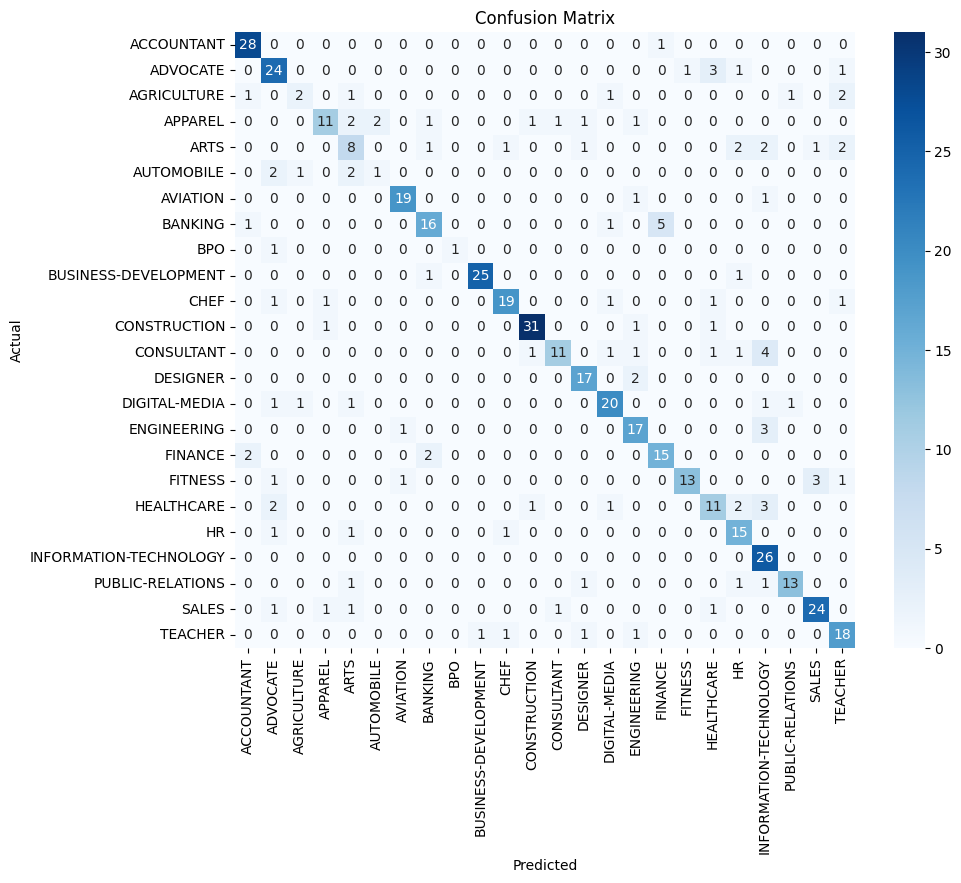

In [20]:
# Compute the confusion matrix
conf_matrix = confusion_matrix(y_test, y_pred)

# Plot the confusion matrix as a heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=label_encoder.classes_, yticklabels=label_encoder.classes_)
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()


# Model whiteboxing

In [21]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import os
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.preprocessing import LabelEncoder

# Assume data_cleaned['Resume_str_cleaned'] and data_cleaned['Category'] are already available
# You can replace this with your actual cleaned data and categories

# Convert the cleaned text data to TF-IDF vectors
tfidf = TfidfVectorizer(max_features=10000, ngram_range=(1, 2))
X = tfidf.fit_transform(data_cleaned['Resume_str_cleaned'])

# Convert labels to numerical format using LabelEncoder
label_encoder = LabelEncoder()
y = label_encoder.fit_transform(data_cleaned['Category'])

# Inverse transform labels to get the original class names
y_labels = label_encoder.inverse_transform(y)

# Convert the sparse matrix to a dense format for easier handling in plots
X_dense = X.toarray()

# Convert the TF-IDF matrix and labels to a DataFrame for easier processing
tfidf_df = pd.DataFrame(X_dense, columns=tfidf.get_feature_names_out())
tfidf_df['Class'] = y_labels

# Initialize a plot
plt.figure(figsize=(12, 8))

# Loop through each class to get the top 3 features
for class_name in tfidf_df['Class'].unique():
    class_data = tfidf_df[tfidf_df['Class'] == class_name].drop(columns=['Class'])

    # Calculate the mean TF-IDF score and get the top 3 features for this class
    mean_scores = class_data.mean(axis=0).sort_values(ascending=False).head(3)
    print(class_name+":")
    # Plot the top 3 features for this class
    for feature in mean_scores.index:
        plt.barh(f"{class_name} - {feature}", mean_scores[feature], color=np.random.rand(3,))

# Customize the plot
plt.title("Top 3 TF-IDF Features for Each Class")
plt.xlabel("Mean TF-IDF Score")
plt.ylabel("Classes and Features")
plt.tight_layout()

# Save the plot as a JPEG
output_path = "top_3_features_per_class.jpeg"
plt.savefig(output_path, format='jpeg', bbox_inches='tight')
plt.close()

print(f"Graph saved as {output_path}")


HR:
DESIGNER:
INFORMATION-TECHNOLOGY:
TEACHER:
ADVOCATE:
BUSINESS-DEVELOPMENT:
HEALTHCARE:
FITNESS:
AGRICULTURE:
BPO:
SALES:
CONSULTANT:
DIGITAL-MEDIA:
AUTOMOBILE:
CHEF:
FINANCE:
APPAREL:
ENGINEERING:
ACCOUNTANT:
CONSTRUCTION:
PUBLIC-RELATIONS:
BANKING:
ARTS:
AVIATION:
Graph saved as top_3_features_per_class.jpeg


In [22]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import os
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.preprocessing import LabelEncoder




tfidf = TfidfVectorizer(max_features=10000, ngram_range=(1, 2))
X = tfidf.fit_transform(data_cleaned['Resume_str_cleaned'])


label_encoder = LabelEncoder()
y = label_encoder.fit_transform(data_cleaned['Category'])


y_labels = label_encoder.inverse_transform(y)

X_dense = X.toarray()

tfidf_df = pd.DataFrame(X_dense, columns=tfidf.get_feature_names_out())
tfidf_df['Class'] = y_labels

top_features_dict = {}

# Initialize a plot
plt.figure(figsize=(12, 8))

# Loop through each class to get the top 3 features
for class_name in tfidf_df['Class'].unique():
    class_data = tfidf_df[tfidf_df['Class'] == class_name].drop(columns=['Class'])

    # Calculate the mean TF-IDF score and get the top 3 features for this class
    mean_scores = class_data.mean(axis=0).sort_values(ascending=False).head(3)

    # Store the top 3 feature names for this class
    top_features_dict[class_name] = mean_scores.index.tolist()

    # Plot the top 3 features for this class
    for feature in mean_scores.index:
        plt.barh(f"{class_name} - {feature}", mean_scores[feature], color=np.random.rand(3,))

plt.title("Top 3 TF-IDF Features for Each Class")
plt.xlabel("Mean TF-IDF Score")
plt.ylabel("Classes and Features")
plt.tight_layout()

output_path = "top_3_features_per_class.jpeg"
plt.savefig(output_path, format='jpeg', bbox_inches='tight')
plt.close()


for class_name, features in top_features_dict.items():
    print(f"Top 3 features for {class_name}: {features}")


with open("top_3_features_per_class.txt", "w") as f:
    for class_name, features in top_features_dict.items():
        f.write(f"Top 3 features for {class_name}: {features}\n")

print(f"Graph saved as {output_path}")
print("Top features saved to top_3_features_per_class.txt")


Top 3 features for HR: ['employee', 'human resource', 'human']
Top 3 features for DESIGNER: ['design', 'designer', 'graphic']
Top 3 features for INFORMATION-TECHNOLOGY: ['network', 'technology', 'system']
Top 3 features for TEACHER: ['student', 'teacher', 'child']
Top 3 features for ADVOCATE: ['customer', 'patient', 'advocate']
Top 3 features for BUSINESS-DEVELOPMENT: ['sale', 'business', 'business development']
Top 3 features for HEALTHCARE: ['patient', 'healthcare', 'care']
Top 3 features for FITNESS: ['fitness', 'customer', 'exercise']
Top 3 features for AGRICULTURE: ['agriculture', 'student', 'program']
Top 3 features for BPO: ['management', 'client', 'network']
Top 3 features for SALES: ['sale', 'customer', 'service']
Top 3 features for CONSULTANT: ['consultant', 'business', 'management']
Top 3 features for DIGITAL-MEDIA: ['medium', 'marketing', 'digital']
Top 3 features for AUTOMOBILE: ['customer', 'claim', 'service']
Top 3 features for CHEF: ['food', 'chef', 'kitchen']
Top 3 fea

In [23]:
!pip install matplotlib seaborn pandas


In [24]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np
import os
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.preprocessing import LabelEncoder



tfidf = TfidfVectorizer(max_features=10000, ngram_range=(1, 2))
X = tfidf.fit_transform(data_cleaned['Resume_str_cleaned'])


label_encoder = LabelEncoder()
y = label_encoder.fit_transform(data_cleaned['Category'])

y_labels = label_encoder.inverse_transform(y)


X_dense = X.toarray()

tfidf_df = pd.DataFrame(X_dense, columns=tfidf.get_feature_names_out())
tfidf_df['Class'] = y_labels


output_dir = "test_class_kde_plots"
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

for class_name in tfidf_df['Class'].unique():
    class_data = tfidf_df[tfidf_df['Class'] == class_name].drop(columns=['Class'])


    top_features = class_data.var().sort_values(ascending=False).head(3).index

    plt.figure(figsize=(10, 6))
    for feature in top_features:
        sns.kdeplot(class_data[feature], label=feature, fill=True, common_norm=False)

    plt.title(f"KDE Plot for {class_name}")
    plt.xlabel("TF-IDF Score")
    plt.ylabel("Density")
    plt.legend()

    # Save the plot as a PDF
    output_path = os.path.join(output_dir, f"{class_name}_kde_plot.pdf")
    plt.savefig(output_path, format='pdf', bbox_inches='tight')
    plt.close()

print(f"KDE plots saved in {output_dir}")


/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  

KDE plots saved in test_class_kde_plots


In [25]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np
import os
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.preprocessing import LabelEncoder

tfidf = TfidfVectorizer(max_features=10000, ngram_range=(1, 2))
X = tfidf.fit_transform(data_cleaned['Resume_str_cleaned'])

label_encoder = LabelEncoder()
y = label_encoder.fit_transform(data_cleaned['Category'])


y_labels = label_encoder.inverse_transform(y)


X_dense = X.toarray()

tfidf_df = pd.DataFrame(X_dense, columns=tfidf.get_feature_names_out())
tfidf_df['Class'] = y_labels


top_features = tfidf_df.drop(columns=['Class']).var().sort_values(ascending=False).head(3).index


plt.figure(figsize=(12, 8))
for class_name in tfidf_df['Class'].unique():
    class_data = tfidf_df[tfidf_df['Class'] == class_name]

    for feature in top_features:
        sns.kdeplot(class_data[feature], label=f"{class_name} - {feature}", fill=True, common_norm=False)

plt.title("PDF Distribution for Each Class")
plt.xlabel("TF-IDF Score")
plt.ylabel("Density")
plt.legend(loc='upper right', bbox_to_anchor=(1.25, 1))
plt.tight_layout()


output_path = "class_pdf_distribution.jpeg"
plt.savefig(output_path, format='jpeg', bbox_inches='tight')
plt.close()

print(f"PDF distribution plot saved as {output_path}")


/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  

PDF distribution plot saved as class_pdf_distribution.jpeg
